<a href="https://colab.research.google.com/github/konderal333/HGT-2022-EmDomArDon/blob/main/speaker_indep.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Loading the data

In [1]:
%%capture
!pip install fastdtw
!pip install pysptk
!pip install pyworld

In [37]:
!git clone https://github.com/v-artur/Golden_Oreos

Cloning into 'Golden_Oreos'...
remote: Enumerating objects: 600, done.
remote: Counting objects: 100% (146/146), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 600 (delta 107), reused 136 (delta 101), pack-reused 454
Receiving objects: 100% (600/600), 17.40 MiB | 12.66 MiB/s, done.
Resolving deltas: 100% (384/384), done.


In [38]:
import reconstructWave as rW
import MelFilterBank as mel

## 1

In [ ]:
# # Obtaining the data and the modules

# # AE data
# #train set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1-HYBWzVl-Ofysa7ymqKjwbTwKYxhFrQA' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1-HYBWzVl-Ofysa7ymqKjwbTwKYxhFrQA" -O train.pkl && rm -rf /tmp/cookies.txt
# #validation set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1tuEJ2pPgm09KgXhmscXErp9zUMfg09mK' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1tuEJ2pPgm09KgXhmscXErp9zUMfg09mK" -O val.pkl && rm -rf /tmp/cookies.txt
# #test set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=14PnH-er4KYUnDPyOGL5Cz8X5V6KS6yGB' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=14PnH-er4KYUnDPyOGL5Cz8X5V6KS6yGB" -O test.pkl && rm -rf /tmp/cookies.txt

# # Incremental PCA data
# #train set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1OLL8rETVIaifkeWioA6mKOa6u6ewO-J1' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1OLL8rETVIaifkeWioA6mKOa6u6ewO-J1" -O train_v2.pkl && rm -rf /tmp/cookies.txt
# #validation set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1-AvUTiOpPFibKnzZYpKGbn33rNZJJYst' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1-AvUTiOpPFibKnzZYpKGbn33rNZJJYst" -O val_v2.pkl && rm -rf /tmp/cookies.txt
# #test set
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1-GL33jBvYeB5sRnWnnHtroEBE9hdwpyh' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1-GL33jBvYeB5sRnWnnHtroEBE9hdwpyh" -O test_v2.pkl && rm -rf /tmp/cookies.txt


# #reconstruction module
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1_eeG0d_r-RqazUkr-ZRPNC6L13sHYwIP' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1_eeG0d_r-RqazUkr-ZRPNC6L13sHYwIP" -O reconstructWave.py && rm -rf /tmp/cookies.txt
# #Melfiltebank applier
# !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1Bjf3ncRe8CcWHl3i0HxRo4unRYkz2fog' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1Bjf3ncRe8CcWHl3i0HxRo4unRYkz2fog" -O MelFilterBank.py && rm -rf /tmp/cookies.txt


In [ ]:
# # Extracting the data from the AE model
# import pickle

# # Train
# with open('train.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_train, y_train = obj[0], obj[1]

# # Validation
# with open('val.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_val, y_val = obj[0], obj[1]

# # Test
# with open('test.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_test, y_test = obj[0], obj[1]

In [ ]:
# # Extracting the data from the Incremental PCA model
# import pickle

# # Train
# with open('train_v2.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_train2, y_train2 = obj[0], obj[1]

# # Validation
# with open('val_v2.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_val2, y_val2 = obj[0], obj[1]

# # Test
# with open('test_v2.pkl', 'rb') as f:
#   obj = pickle.load(f)
#   X_test2, y_test2 = obj[0], obj[1]

## 2

If previous one does not work:

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
# Extracting the data from the AE model
import pickle

# Train
with open('/content/drive/MyDrive/train.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_train, y_train = obj[0], obj[1]

# Validation
with open('/content/drive/MyDrive/val.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_val, y_val = obj[0], obj[1]

# Test
with open('/content/drive/MyDrive/test.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_test, y_test = obj[0], obj[1]

In [8]:
# Extracting the data from the Incremental PCA model

# Train
with open('/content/drive/MyDrive/train_v2.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_train2, y_train2 = obj[0], obj[1]

# Validation
with open('/content/drive/MyDrive/val_v2.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_val2, y_val2 = obj[0], obj[1]

# Test
with open('/content/drive/MyDrive/test_v2.pkl', 'rb') as f:
  obj = pickle.load(f)
  X_test2, y_test2 = obj[0], obj[1]

In [9]:
X_train.shape

(179011, 350)

In [10]:
X_train2.shape

(179011, 250)

# Data preparation

In [ ]:
# TODO for EMESE: ha az AE modelt használod, lehet skálázni kell az adatokat

# Modeling

In [11]:
# Setting seed
import tensorflow as tf
tf.keras.utils.set_random_seed(1234)

In [12]:
from tensorflow.keras import regularizers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import Dense, Dropout, Input, Flatten
import numpy as np

# FC-DNN model
def create_dnn_model(inputsize, outputsize):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Input(shape=(inputsize)))
    model.add(tf.keras.layers.Dense(2000, activation="relu", kernel_initializer='HeNormal'))
    model.add(tf.keras.layers.Dropout(0.3))
    model.add(tf.keras.layers.Dense(1000, activation="relu", kernel_initializer='HeNormal'))
    model.add(tf.keras.layers.Dropout(0.3))
    model.add(tf.keras.layers.Dense(500, activation="relu", kernel_initializer='HeNormal'))
    model.add(tf.keras.layers.Dropout(0.2))
    model.add(tf.keras.layers.Dense(100, activation="relu", kernel_initializer='HeNormal'))
    model.add(tf.keras.layers.Dropout(0.2))
    model.add(tf.keras.layers.Dense(outputsize))
    return model

In [13]:
from scipy.stats import pearsonr

def pearson_corr(preds, y):
  rs = np.zeros((y.shape[1]))

  # Evaluate reconstruction of this fold
  for specBin in range(y.shape[1]):
    r, p = pearsonr(y[:, specBin], preds[:, specBin])
    rs[specBin] = r

  #Show evaluation result
  print('Mean correlation:', np.mean(rs))

FC-DNN

In [14]:
early_stopping = EarlyStopping(patience=10, verbose=1, min_delta=1e-5)
checkpointer = ModelCheckpoint(filepath='weights_fcdnn_1.hdf5', save_best_only=True, verbose=1)

model = create_dnn_model(X_train.shape[1], 23)
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.fit(X_train, y_train, batch_size=256, 
          epochs=100, verbose=1, validation_data=(X_val, y_val), shuffle=True,
          callbacks=[checkpointer, early_stopping])

Epoch 1/100
700/700 [==============================] - ETA: 0s - loss: 6.2928 - mse: 6.2928
Epoch 1: val_loss improved from inf to 4.82168, saving model to weights_fcdnn_1.hdf5
700/700 [==============================] - 6s 6ms/step - loss: 6.2928 - mse: 6.2928 - val_loss: 4.8217 - val_mse: 4.8217
Epoch 2/100
690/700 [============================>.] - ETA: 0s - loss: 4.9933 - mse: 4.9933
Epoch 2: val_loss did not improve from 4.82168
700/700 [==============================] - 3s 5ms/step - loss: 4.9922 - mse: 4.9922 - val_loss: 4.8516 - val_mse: 4.8516
Epoch 3/100
699/700 [============================>.] - ETA: 0s - loss: 4.9327 - mse: 4.9327
Epoch 3: val_loss improved from 4.82168 to 4.80680, saving model to weights_fcdnn_1.hdf5
700/700 [==============================] - 3s 5ms/step - loss: 4.9328 - mse: 4.9328 - val_loss: 4.8068 - val_mse: 4.8068
Epoch 4/100
689/700 [============================>.] - ETA: 0s - loss: 4.9098 - mse: 4.9098
Epoch 4: val_loss improved from 4.80680 to 4.799

In [15]:
model.load_weights('weights_fcdnn_1.hdf5')
model.evaluate(X_test, y_test)

1865/1865 [==============================] - 4s 2ms/step - loss: 4.6757 - mse: 4.6757


[4.6757493019104, 4.6757493019104]

In [16]:
preds1 = model.predict(X_test)
pearson_corr(preds1, y_test)

1865/1865 [==============================] - 3s 2ms/step
Mean correlation: -0.002268709196478792


In [17]:
early_stopping = EarlyStopping(patience=10, verbose=1, min_delta=1e-5)
checkpointer = ModelCheckpoint(filepath='weights_fcdnn_2.hdf5', save_best_only=True, verbose=1)

model = create_dnn_model(X_train2.shape[1], 23)
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.fit(X_train2, y_train2, batch_size=256, 
          epochs=100, verbose=1, validation_data=(X_val2, y_val2), shuffle=True,
          callbacks=[checkpointer, early_stopping])

Epoch 1/100
697/700 [============================>.] - ETA: 0s - loss: 4.5934 - mse: 4.5934
Epoch 1: val_loss improved from inf to 3.34487, saving model to weights_fcdnn_2.hdf5
700/700 [==============================] - 5s 6ms/step - loss: 4.5881 - mse: 4.5881 - val_loss: 3.3449 - val_mse: 3.3449
Epoch 2/100
690/700 [============================>.] - ETA: 0s - loss: 2.7711 - mse: 2.7711
Epoch 2: val_loss did not improve from 3.34487
700/700 [==============================] - 3s 5ms/step - loss: 2.7683 - mse: 2.7683 - val_loss: 3.8181 - val_mse: 3.8181
Epoch 3/100
696/700 [============================>.] - ETA: 0s - loss: 2.4530 - mse: 2.4530
Epoch 3: val_loss improved from 3.34487 to 2.80057, saving model to weights_fcdnn_2.hdf5
700/700 [==============================] - 4s 5ms/step - loss: 2.4515 - mse: 2.4515 - val_loss: 2.8006 - val_mse: 2.8006
Epoch 4/100
691/700 [============================>.] - ETA: 0s - loss: 2.2600 - mse: 2.2600
Epoch 4: val_loss improved from 2.80057 to 2.700

In [18]:
model.load_weights('weights_fcdnn_2.hdf5')
model.evaluate(X_test2, y_test2)

1865/1865 [==============================] - 4s 2ms/step - loss: 2.3089 - mse: 2.3089


[2.3089354038238525, 2.3089354038238525]

In [19]:
preds2 = model.predict(X_test2)
pearson_corr(preds2, y_test2)

1865/1865 [==============================] - 3s 2ms/step
Mean correlation: 0.7291003494098978


## Optimizing

In [ ]:
%%capture
!pip install keras-tuner

In [ ]:
import tensorflow as tf
from tensorflow import keras
import keras_tuner as kt
import scipy.io.wavfile as wavfile

### FC-DNN

In [ ]:
#!rm -r synth_audio_fcdnn_opt
!mkdir synth_audio_fcdnn_opt

In [ ]:
def create_dnn_model_opt(hp):  

  model = tf.keras.Sequential()
  model.add(tf.keras.layers.Input(shape=(250)))

  hp_units_1 = hp.Int('units_1', min_value=100, max_value=150, step=10)
  model.add(tf.keras.layers.Dense(units = hp_units_1, activation="relu", kernel_initializer='HeNormal'))
  model.add(tf.keras.layers.Dropout(rate=hp.Float('dropout_1', min_value = 0.0, max_value = 0.2, default = 0.1, step = 0.04)))

  hp_units_2 = hp.Int('units_2', min_value=100, max_value=140, step=10)
  model.add(tf.keras.layers.Dense(units = hp_units_2, activation="relu", kernel_initializer='HeNormal'))
  model.add(tf.keras.layers.Dropout(rate=hp.Float('dropout_2', min_value = 0.0, max_value = 0.2, default = 0.1, step = 0.04)))

  hp_units_3 = hp.Int('units_3', min_value=60, max_value=80, step=5)
  model.add(tf.keras.layers.Dense(units = hp_units_3, activation="relu", kernel_initializer='HeNormal'))
  model.add(tf.keras.layers.Dropout(rate=hp.Float('dropout_3', min_value = 0.0, max_value = 0.2, default = 0.1, step = 0.04)))

  model.add(tf.keras.layers.Dense(40))

  model.add(tf.keras.layers.Dense(23)) #output

  hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])

  model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                loss='mse',
                metrics=['mse'])
  
  return model

In [ ]:
tuner = kt.Hyperband(create_dnn_model_opt,
                         objective='val_loss',
                         max_epochs=10,
                         factor=2,
                         directory='/content/fcdnn_opt',
                         project_name='dnn_opt')

stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
tuner.search(X_train2, y_train2, epochs=100, batch_size=64, validation_data=(X_val2, y_val2), verbose=0, shuffle=True, callbacks=[stop_early])
best_hps = tuner.get_best_hyperparameters(num_trials=3)[0]

In [ ]:
#Applying the best model
early_stopping = EarlyStopping(patience=10, verbose=1, min_delta=1e-5)
checkpointer = ModelCheckpoint(filepath='weights_fcdnn_opt.hdf5', save_best_only=True, verbose=1)

model = tuner.hypermodel.build(best_hps)
#model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.fit(X_train2, y_train2, batch_size=64, 
                  epochs=100, verbose=0, validation_data=(X_val2, y_val2), shuffle=True,
                  callbacks=[checkpointer, early_stopping])
#predict with the best weights
model.load_weights('weights_fcdnn_opt.hdf5')
preds_fcdnn = model.predict(X_test2, verbose=0)

print("\n")
print(model.evaluate(X_test2, y_test2))
print(pearson_corr(preds_fcdnn, y_test2))


Epoch 1: val_loss improved from inf to 2.31019, saving model to weights_fcdnn_opt.hdf5

Epoch 2: val_loss improved from 2.31019 to 2.19312, saving model to weights_fcdnn_opt.hdf5

Epoch 3: val_loss improved from 2.19312 to 2.14660, saving model to weights_fcdnn_opt.hdf5

Epoch 4: val_loss did not improve from 2.14660

Epoch 5: val_loss did not improve from 2.14660

Epoch 6: val_loss did not improve from 2.14660

Epoch 7: val_loss did not improve from 2.14660

Epoch 8: val_loss did not improve from 2.14660

Epoch 9: val_loss did not improve from 2.14660

Epoch 10: val_loss did not improve from 2.14660

Epoch 11: val_loss did not improve from 2.14660

Epoch 12: val_loss did not improve from 2.14660

Epoch 13: val_loss did not improve from 2.14660
Epoch 13: early stopping
1865/1865 [==============================] - 4s 2ms/step - loss: 2.1524 - mse: 2.1524
[2.1524338722229004, 2.1524338722229004]
Mean correlation: 0.7341382195954761
None


## MCD

In [32]:
#For audio reconstruction and MCD measure 
#dependencies
import reconstructWave as rW
import MelFilterBank as mel
import numpy as np
import librosa
from scipy.io import wavfile
import pysptk
from scipy.spatial.distance import euclidean
import os
from fastdtw import fastdtw

# functions for MCD calculations 
# (source: https://github.com/ttslr/python-MCD?fbclid=IwAR2OFaz3-8kTfhJXC7F-cmTTHkY-egEzZdSYHsC0agwPw58N2G3hqhfdVNY)


#The following function converts a wav file into a format which can be used to evaluate the MCD score
def readmgc(filename):
    sr, x = wavfile.read(filename)
    assert sr == 16000
    x = x.astype(np.float64)
    frame_length = 1024
    hop_length = 256  
    frames = librosa.util.frame(x, frame_length=frame_length, hop_length=hop_length).astype(np.float64).T
    frames *= pysptk.blackman(frame_length)
    assert frames.shape[1] == frame_length 
    order = 25
    alpha = 0.41
    stage = 5
    gamma = -1.0 / stage

    mgc = pysptk.mgcep(frames, order, alpha, gamma)
    mgc = mgc.reshape(-1, order + 1)
    print("mgc of {} is ok!".format(filename))
    return mgc

#this function returns the average MCD score for the reconstructed WAV file by a chosen model
def compute_mcd(synth_folder):
  '''
  :param synth_folder: the folder in which the reconstructed WAV file can be found
  '''
  #computational parameters
  _logdb_const = 10.0 / np.log(10.0) * np.sqrt(2.0)
  s = 0.0
  framesTot = 0

  # computing the MCD
  files = os.listdir(synth_folder)
  for subject in files:

    # this is necessary because of the .ipynb_checkpoints files
    if subject.startswith('.'):
      continue
      
    print("Processing -----------{}".format(subject))
    

    # obtaining the mgc features
    subject_ID = subject[0:6]
    filename1 = '/content/orig.wav'
    mgc1 = readmgc(filename1)
    filename2 = synth_folder + 'predicted.wav'
    mgc2 = readmgc(filename2)
  
    x = mgc1
    y = mgc2
    
    # calculating the mcd
    distance, path = fastdtw(x, y, dist=euclidean)
  
    distance/= (len(x) + len(y))
    pathx = list(map(lambda l: l[0], path))
    pathy = list(map(lambda l: l[1], path))
    x, y = x[pathx], y[pathy]

    frames = x.shape[0]
    framesTot  += frames

    z = x - y
    s += np.sqrt((z * z).sum(-1)).sum()

  MCD_value = _logdb_const * float(s) / float(framesTot)

  print("MCD = : {:f}".format(MCD_value))


#Reconstructing the WAV file from the predicted mel-log spectrogram (Griffin-Lim method)
def createAudioorig(spectrogram, audiosr=16000, winLength=0.05, frameshift=0.01):
    mfb = mel.MelFilterBank(int((audiosr*winLength)/2+1), spectrogram.shape[1], audiosr)
    hop = int(spectrogram.shape[0])
    rec_audio = np.array([])
    for_reconstruction = mfb.fromLogMels(spectrogram)
    for w in range(0,spectrogram.shape[0],hop):
        spec = for_reconstruction[w:min(w+hop,for_reconstruction.shape[0]),:]
        rec = rW.reconstructWavFromSpectrogram(spec,spec.shape[0]*spec.shape[1],fftsize=int(audiosr*winLength),overlap=int(winLength/frameshift))
        rec_audio = np.append(rec_audio,rec)
    scaled = np.int16(rec_audio/np.max(np.abs(rec_audio)) * 32767)
    return scaled

def createAudio(spectrogram, audiosr=16000, winLength=0.05, frameshift=0.01):
    mfb = mel.MelFilterBank(int((audiosr*winLength)/2+1), spectrogram.shape[1], audiosr)
    hop = int(spectrogram.shape[0])
    rec_audio = np.array([])
    # we needed to change the exponential function to power function
    for_reconstruction = makeNormal(np.dot(np.power(spectrogram, 4), mfb.melInvMatrix))
    for w in range(0,spectrogram.shape[0],hop):
        spec = for_reconstruction[w:min(w+hop,for_reconstruction.shape[0]),:]
        rec = rW.reconstructWavFromSpectrogram(spec,spec.shape[0]*spec.shape[1],fftsize=int(audiosr*winLength),overlap=int(winLength/frameshift))
        rec_audio = np.append(rec_audio,rec)
    scaled = np.int16(rec_audio/np.max(np.abs(rec_audio)) * 32767)
    return scaled

#Small helping function to filter out NaNs and infintes during the audio reconstruction
def makeNormal(x):
    nanIdx = np.isnan(x)
    x[nanIdx] = 0
    
    infIdx = np.isinf(x)
    x[infIdx] = 0

    return x

In [21]:
import matplotlib.pyplot as plt
import librosa
import pyworld

In [22]:
#Audio Reconstruction parameters
winLength = 0.05
frameshift = 0.01
audiosr = 16000

In [23]:
#source: https://github.com/SamuelBroughton/Mel-Cepstral-Distortion/blob/master/mel-cepstral-distortion.ipynb
def load_wav(wav_file, sr):
    """
    Load a wav file with librosa.
    :param wav_file: path to wav file
    :param sr: sampling rate
    :return: audio time series numpy array
    """
    wav, _ = librosa.load(wav_file, sr=sr, mono=True)

    return wav

In [33]:
!rm -r synth_audio_fcdnn
#!rm -r sample_data

In [34]:
!mkdir synth_audio_fcdnn

In [35]:
reconstructedWav_fcdnn = createAudio(preds2, audiosr=audiosr, winLength=winLength, frameshift=frameshift) # preds_fcdnn
wavfile.write(os.path.join('/content/synth_audio_fcdnn/predicted.wav'), int(audiosr), reconstructedWav_fcdnn)

In [28]:
# creating the comparison from parts of the original wav files
import os
feat_path = '/content/drive/MyDrive/features'

aggregated = np.array([])
for index, subject in enumerate(['01','02','03','04','05','06','07','08','09','10']):
  sub_wav = load_wav(os.path.join(feat_path,f'sub-{subject}_orig_audio.wav'), 16000)
  needed_part = np.array_split(sub_wav, 5)[(index+4) % 5]
  aggregated = np.concatenate((aggregated, needed_part))

wavfile.write(os.path.join('/content/orig.wav'), int(audiosr), aggregated)

In [ ]:
from IPython.display import Audio 
Audio('/content/drive/MyDrive/features/sub-01_orig_audio.wav', autoplay=True)

In [ ]:
Audio('/content/orig.wav')

In [ ]:
Audio('/content/synth_audio_fcdnn/predicted.wav', autoplay=True)

In [36]:
compute_mcd('/content/synth_audio_fcdnn/')

Processing -----------predicted.wav


RuntimeError: ignored

In [30]:
orig = load_wav('/content/orig.wav', 16000)
rec_fcdnn = load_wav('/content/synth_audio_fcdnn/predicted.wav', 16000)

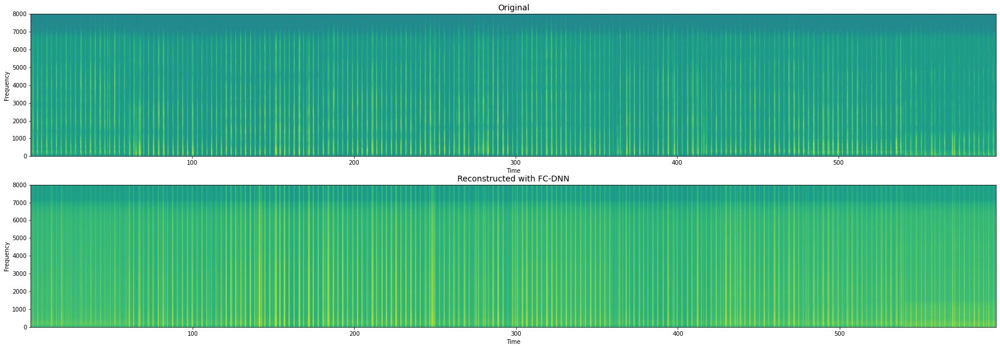

In [31]:
# plotting the spectograms of the original audiofile and the reconstructed file
plt.figure(figsize = (30,10))
plt.subplot(211)
plt.specgram(orig, Fs=16000)
plt.title('Original', fontsize=14)
plt.xlabel('Time')
plt.ylabel('Frequency') 

plt.subplot(212)
plt.specgram(rec_fcdnn, Fs=16000)
plt.title('Reconstructed with FC-DNN', fontsize=14)
plt.xlabel('Time')
plt.ylabel('Frequency')

plt.show()